In [1]:
import numpy as np
from scipy.sparse import csr_matrix, find
from scipy.spatial import cKDTree
from tqdm import tqdm_notebook as tqdm

from datasets.graph import draw_sample
import torch

#model_fname = '/data/gnn_code/hgcal_ldrd/output/checkpoints/model_checkpoint_EdgeNetWithCategories_264403_5b5c05404f_markus.best.pth.tar'
model_fname = '/data/gnn_code/hgcal_ldrd/output/checkpoints/model_checkpoint_EdgeNetWithCategories_259075_140efb4178_markus.best.pth.tar'
plot_prefix = '/data/gnn_code/hgcal_ldrd/plots/all_'

#test_fname = '/data/test/processed/data_40.pt'
test_fname = '/data/all_track/processed/data_8849.pt'



#weird stuff
#'/home/lagray/training_data/single_taus/test/processed/data_39.pt'
#'/home/lagray/training_data/single_taus/test/processed/data_41.pt'
#'/home/lagray/training_data/single_taus/test/processed/data_2.pt'
#'/home/lagray/training_data/single_taus/test/processed/data_26.pt'

In [2]:
from models.EdgeNetWithCategories import EdgeNetWithCategories

#mdl = EdgeNetWithCategories(input_dim=5, hidden_dim=64, output_dim=4, n_iters=6).to('cuda:0')
mdl = EdgeNetWithCategories(input_dim=3, hidden_dim=64, output_dim=2, n_iters=6).to('cuda:0')

mdl.load_state_dict(torch.load(model_fname)['model'])
mdl.eval()

EdgeNetWithCategories(
  (inputnet): Sequential(
    (0): Linear(in_features=3, out_features=128, bias=True)
    (1): Tanh()
    (2): Linear(in_features=128, out_features=128, bias=True)
    (3): Tanh()
    (4): Linear(in_features=128, out_features=64, bias=True)
    (5): Tanh()
  )
  (edgenetwork): Sequential(
    (0): Linear(in_features=768, out_features=128, bias=True)
    (1): ELU(alpha=1.0)
    (2): Linear(in_features=128, out_features=128, bias=True)
    (3): ELU(alpha=1.0)
    (4): Linear(in_features=128, out_features=2, bias=True)
    (5): LogSoftmax()
  )
  (nodenetwork0): EdgeConv(nn=Sequential(
    (0): Linear(in_features=134, out_features=99, bias=True)
    (1): ELU(alpha=1.0)
    (2): Linear(in_features=99, out_features=64, bias=True)
    (3): ELU(alpha=1.0)
  ))
  (nodenetwork1): EdgeConv(nn=Sequential(
    (0): Linear(in_features=134, out_features=99, bias=True)
    (1): ELU(alpha=1.0)
    (2): Linear(in_features=99, out_features=64, bias=True)
    (3): ELU(alpha=1.0)
  

In [3]:
#test_fname = '/data/test/processed/data_40.pt'
test_fname = '/data/all_track/processed/data_8849.pt'

data = torch.load(test_fname).to('cuda:0')

In [4]:
with torch.no_grad():
    pred_edges = mdl(data).detach()
    pred_edges_np = pred_edges.cpu().numpy()

In [5]:
print(np.unique(np.argmax(pred_edges_np,axis=-1), return_counts=True))
print(torch.unique(data.y.cpu(), return_counts=True))

(array([0, 1]), array([1859, 2149]))
(tensor([0, 1]), tensor([1842, 2166]))


In [6]:
%matplotlib inline

import matplotlib.pyplot as plt
from matplotlib import collections  as mc

def draw_sample(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 20))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    
    
    ax0.scatter(np.pi*X[:,1], 1000*X[:,0], s=(e_normed), c='k')
    ax1.scatter(1000*X[:,2], 1000*X[:,0], s=(e_normed), c='k')
    ax2.scatter(1000*X[:,2], np.pi*X[:,1], s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            lines0.append([(np.pi*feats_o[j,1], 1000*feats_o[j,0]), (np.pi*feats_i[j,1], 1000*feats_i[j,0])])
            lines1.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
            lines2.append([(1000*feats_o[j,2],  np.pi*feats_o[j,1]),(1000*feats_i[j,2],  np.pi*feats_i[j,1])])
            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            ax0.plot([np.pi*feats_o[j,1], np.pi*feats_i[j,1]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax1.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax2.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [np.pi*feats_o[j,1], np.pi*feats_i[j,1]], '-', **seg_args)
        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$Phi$')
    ax0.set_ylabel('$R [mm]$')
    ax0.set_xlim(-3.5, 3.5)
    ax0.set_ylim(0, 1050)
    
    ax1.set_xlabel('$Z [mm]$')
    ax1.set_ylabel('$R [mm]$')
    ax1.set_xlim(-1200, 1200)
    ax1.set_ylim(0, 1050)
    
    ax2.set_xlabel('$Z [mm]$')
    ax2.set_ylabel('$Phi$')
    ax2.set_xlim(-1200, 1200)
    ax2.set_ylim(-3.5, 3.5)
    

    plt.tight_layout()
    fig.savefig(plot_prefix + 'edges.png')
    #return fig;

In [7]:
#print()

X = data.x.cpu().numpy()
index = data.edge_index.cpu().numpy().T
Ro = index[:,0]
Ri = index[:,1]
y = data.y.cpu().numpy()

out = np.argmax(pred_edges_np,axis=-1)


/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/matplotlib/collections.py:857: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor
/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


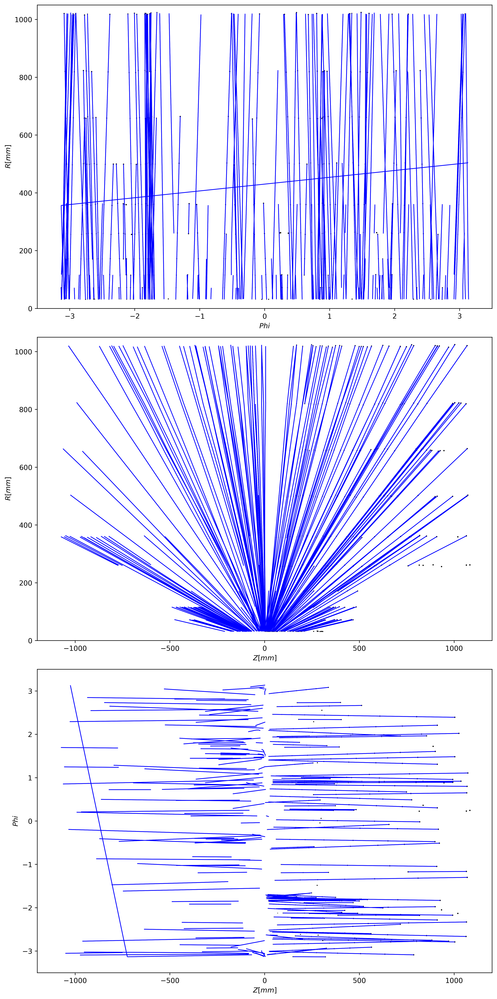

In [8]:
draw_sample(X, Ri, Ro, y, y)

/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


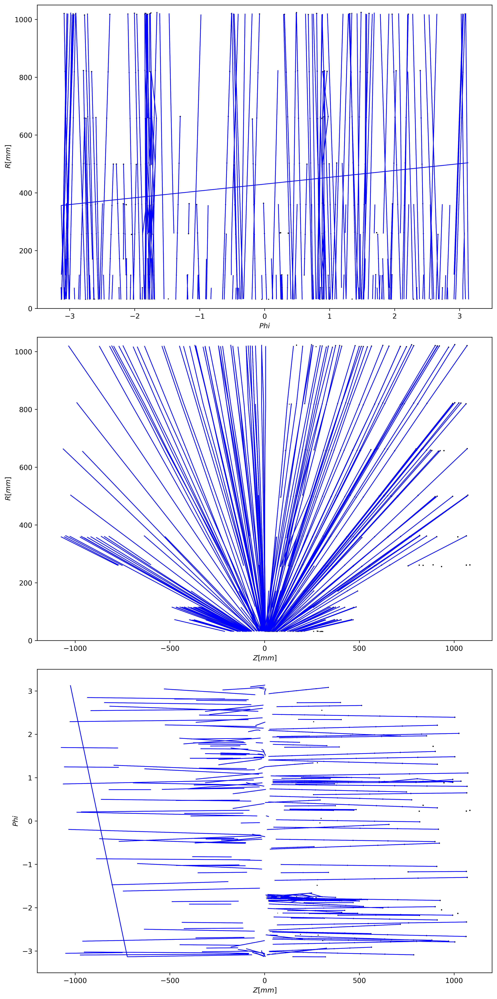

In [9]:
draw_sample(X, Ri, Ro, y, out)

(4008, 2)

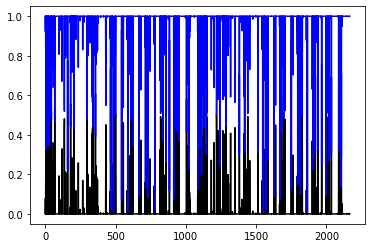

In [10]:
thecats = np.argmax(pred_edges_np,axis=-1)
plt.plot(np.exp(pred_edges_np[:,0][y != 0]),color='black')
plt.plot(np.exp(pred_edges_np[:,1][y != 0]),color='blue')
#plt.plot(np.exp(pred_edges_np[:,2][y != 0]),color='red')
#plt.plot(np.exp(pred_edges_np[:,3][y != 0]),color='green')
pred_edges_np.shape

50 50


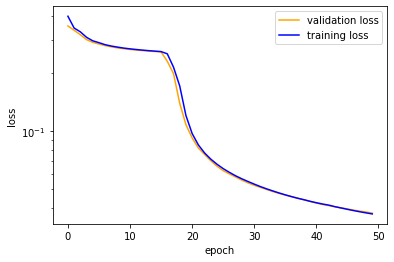

In [11]:
validation_loss = np.array([0.35303630228601607, 0.33517733321519894, 0.31811762050551884, 0.2999203449504524, 0.2901383298601808, 0.2845521632729277, 0.2790628186306037, 0.27498714066831403, 0.2715734135969884, 0.26882641586543476, 0.2665477971320098, 0.2646839737976338, 0.26306010793663015, 0.26157249085983986, 0.26015759347859074, 0.2589488988963224, 0.23143416729434735, 0.19954975920040055, 0.140100735293354, 0.1084293874475242, 0.09260802349696556, 0.08209326578156843, 0.07597380953493639, 0.07051265062211808, 0.06606178404842267, 0.06258605849366151, 0.06020290494586031, 0.058051406943875936, 0.055885735810287086, 0.05409921309739709, 0.052534127420295916, 0.051249320234506165, 0.0499842338136392, 0.04875616394976512, 0.04767934203234706, 0.046768446882008076, 0.045918883704369896, 0.04504803520624689, 0.04420356053739292, 0.04332198757463856, 0.042508899715418616, 0.04174961452234252, 0.04124378392875384, 0.04062303771833116, 0.04014001481417872, 0.03961967893469668, 0.03907004267665937, 0.038592744325248174, 0.038214756397130546, 0.037675226121939624])
training_loss = np.array([0.39654098859446196, 0.3443744834749249, 0.32912571771638627, 0.30824944694095036, 0.2956418134324716, 0.28907781002101207, 0.28219009832463277, 0.2776213019881082, 0.27410447466355553, 0.27095243893037574, 0.26851474937172554, 0.266437733055245, 0.26449192345594874, 0.2627895620762039, 0.2612616848332102, 0.2599104499131294, 0.25304691893269576, 0.21575611898817626, 0.1723601791664358, 0.12104022030907388, 0.09759931772492503, 0.08517679666088582, 0.07738700137668655, 0.07185107867565929, 0.06760538670169104, 0.06413945089828349, 0.06133171169926369, 0.05886303581198165, 0.05679354726336156, 0.05498005584052351, 0.05329111162946557, 0.051730978980873456, 0.050352592546760666, 0.04910790048035706, 0.04794523971888678, 0.046871804098743065, 0.04589788271374541, 0.04499747757958597, 0.04422925197854837, 0.043393471155375944, 0.04266200886764112, 0.04201801652986129, 0.041456335181647375, 0.04069687297504133, 0.04005623841100976, 0.03943029667621464, 0.03883756811103146, 0.03829555612872555, 0.037785244570479055, 0.037325483722474545])
learning_rate = np.concatenate((np.full(18, 1e-4),np.full(24-18, 2e-5),
                                np.full(30-24, 4e-6),np.full(36-30,8e-7),
                                np.full(39-36, 1.6e-7)))
#Epoch    18: reducing learning rate of group 0 to 2.0000e-05.
#Epoch    24: reducing learning rate of group 0 to 4.0000e-06.
#Epoch    30: reducing learning rate of group 0 to 8.0000e-07.
#Epoch    36: reducing learning rate of group 0 to 1.6000e-07.

                               
                               
print(validation_loss.size, training_loss.size)

plt.yscale('log')
plt.plot(validation_loss, color='orange', label='validation loss')
plt.plot(training_loss, color='blue', label='training loss')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.savefig(plot_prefix + 'loss.png')

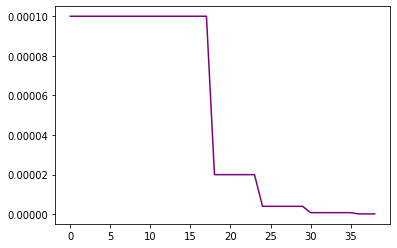

In [12]:
plt.plot(learning_rate, color='purple')

In [13]:
from unionfind import unionfind
finder_had = unionfind(X.shape[0])
finder_pho = unionfind(X.shape[0])
finder_mip = unionfind(X.shape[0])

for i in tqdm(range(index.shape[0])):
    if out[i] == 1:
        finder_had.unite(index[i,0], index[i,1])
    if out[i] == 2:
        finder_pho.unite(index[i,0], index[i,1])
    if out[i] == 3:
        finder_mip.unite(index[i,0], index[i,1])

had_roots = np.array([finder_had.find(i) for i in range(X.shape[0])], dtype=np.uint32)
pho_roots = np.array([finder_pho.find(i) for i in range(X.shape[0])], dtype=np.uint32)
mip_roots = np.array([finder_mip.find(i) for i in range(X.shape[0])], dtype=np.uint32)


/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


In [14]:
had_clusters = np.unique(had_roots, return_inverse=True, return_counts=True)
pho_clusters = np.unique(pho_roots, return_inverse=True, return_counts=True)
mip_clusters = np.unique(mip_roots, return_inverse=True, return_counts=True)

hads = had_clusters[0][np.where(had_clusters[2] > 4)]
ems = pho_clusters[0][np.where(pho_clusters[2] > 4)]
mips = mip_clusters[0][np.where(mip_clusters[2] > 4)]

had_clusters_sel = {i: np.where(had_roots == had)[0] for i, had in enumerate(hads)}
em_clusters_sel = {i: np.where(pho_roots == em)[0] for i, em in enumerate(ems)}
mip_clusters_sel = {i: np.where(mip_roots == mip)[0] for i, mip in enumerate(mips)}

print(had_clusters_sel)
print(em_clusters_sel)
print(mip_clusters_sel)

print(had_clusters[2][np.where(had_clusters[2] > 4)])
print(pho_clusters[2][np.where(pho_clusters[2] > 4)])
print(mip_clusters[2][np.where(mip_clusters[2] > 4)])

{0: array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), 1: array([ 10,  11,  12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,
        23,  24,  25,  26,  27, 525, 526]), 2: array([28, 29, 30, 31, 32, 33, 34, 35, 36]), 3: array([37, 38, 39, 40, 41, 42, 43, 44, 45, 46]), 4: array([53, 54, 55, 63, 64, 65]), 5: array([67, 68, 69, 70, 71, 72, 73, 74, 75, 76]), 6: array([ 93,  94,  95,  96, 413, 414, 415, 416, 417, 418, 892]), 7: array([ 97,  98,  99, 100, 101, 102, 103, 104, 105, 106]), 8: array([107, 108, 109, 110, 111, 112, 113, 114, 115, 116]), 9: array([117, 118, 119, 120, 121, 122]), 10: array([127, 128, 129, 130, 131, 132]), 11: array([133, 134, 135, 136, 137, 138, 139, 140, 141, 142]), 12: array([167, 168, 169, 170, 171, 172, 173]), 13: array([174, 175, 176, 177, 178, 179, 180, 181]), 14: array([185, 186, 187, 188, 189, 190]), 15: array([191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 382]), 16: array([201, 202, 203, 204, 205, 206, 207, 208, 209, 210]), 17: array([222, 223, 224, 225, 226, 

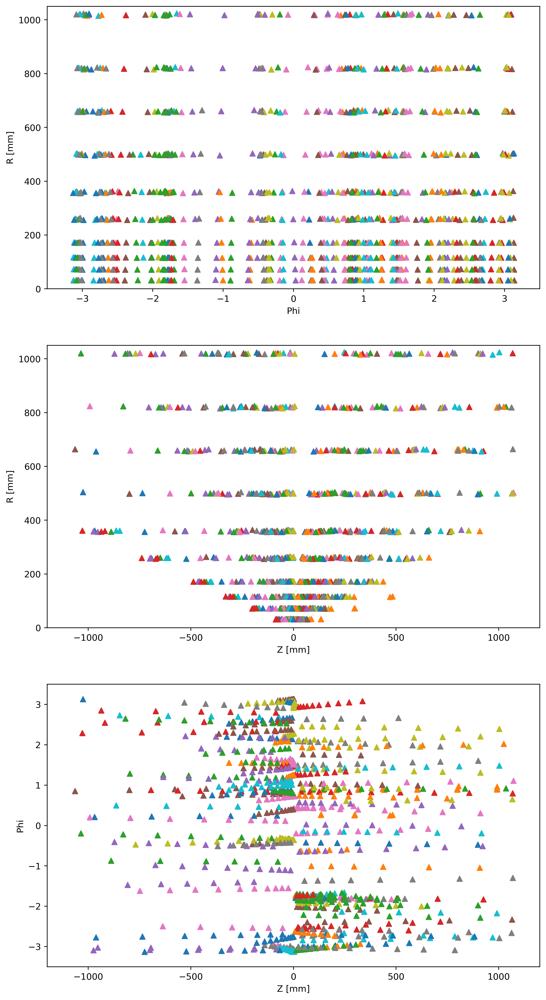

In [15]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

%matplotlib inline


fig, ax = plt.subplots(3, 1, dpi=400, figsize=(10, 20))

ax[0].set_xlabel('Phi')
ax[0].set_ylabel('R [mm]')
ax[0].set_xlim(-3.5, 3.5)
ax[0].set_ylim(0, 1050)

ax[1].set_xlabel('Z [mm]')
ax[1].set_ylabel('R [mm]')
ax[1].set_xlim(-1200, 1200)
ax[1].set_ylim(0, 1050)

ax[2].set_xlabel('Z [mm]')
ax[2].set_ylabel('Phi')
ax[2].set_xlim(-1200, 1200)
ax[2].set_ylim(-3.5, 3.5)

#ax[3].set_xlabel('X [mm]')
#ax[3].set_ylabel('Y [mm]')
#ax[3].set_xlim(-1050, 1050)
#ax[3].set_ylim(-1050, 1050)

for k, clus in had_clusters_sel.items():
    clu = X[clus]
    ax[0].scatter(np.pi*clu[:,1], 1000*clu[:,0], marker = '^')
    ax[1].scatter(1000*clu[:,2], 1000*clu[:,0], marker = '^')
    ax[2].scatter(1000*clu[:,2], np.pi*clu[:,1], marker = '^')
#    ax[3].scatter(1000*clu[:,0]*np.cos(np.pi*clu[:,1]), 1000*clu[:,0]*np.sin(np.pi*clu[:,1]), marker = '^')

#for k, clus in em_clusters_sel.items():
#    clu = X[clus]
#    ax[0].scatter(clu[:,0], clu[:,1], marker = 'o')
#    ax[1].scatter(clu[:,0], clu[:,2], marker = 'o')
#    ax[2].scatter(clu[:,1], clu[:,2], marker = 'o')
#for k, clus in mip_clusters_sel.items():
#    clu = X[clus]
#    ax[0].scatter(clu[:,0], clu[:,1], marker = '+')#, clu[:,2])
#    ax[1].scatter(clu[:,0], clu[:,2], marker = '+')#, clu[:,2])
#    ax[2].scatter(clu[:,1], clu[:,2], marker = '+')#, clu[:,2])

fig.savefig(plot_prefix + 'clusters.png')

In [16]:
#%matplotlib inline

#import matplotlib.pyplot as plt
#from matplotlib import collections  as mc

def draw_sample_with_clusters(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 20))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    
    
    ax0.scatter(np.pi*X[:,1], 1000*X[:,0], s=(e_normed), c='k')
    ax1.scatter(1000*X[:,2],  1000*X[:,0], s=(e_normed), c='k')
    ax2.scatter(1000*X[:,2],  np.pi*X[:,1], s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            lines0.append([(np.pi*feats_o[j,1], 1000*feats_o[j,0]), (np.pi*feats_i[j,1], 1000*feats_i[j,0])])
            lines1.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
            lines2.append([(1000*feats_o[j,2],  np.pi*feats_o[j,1]),(1000*feats_i[j,2],  np.pi*feats_i[j,1])])
            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            ax0.plot([np.pi*feats_o[j,1], np.pi*feats_i[j,1]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax1.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax2.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [np.pi*feats_o[j,1], np.pi*feats_i[j,1]], '-', **seg_args)
        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$Phi$')
    ax0.set_ylabel('$R [mm]$')
    ax0.set_xlim(-3.5, 3.5)
    ax0.set_ylim(0, 1050)
    
    ax1.set_xlabel('$Z [mm]$')
    ax1.set_ylabel('$R [mm]$')
    ax1.set_xlim(-1200, 1200)
    ax1.set_ylim(0, 1050)
    
    ax2.set_xlabel('$Z [mm]$')
    ax2.set_ylabel('$Phi$')
    ax2.set_xlim(-1200, 1200)
    ax2.set_ylim(-3.5, 3.5)
    
    for k, clus in had_clusters_sel.items():
        clu = X[clus]
        ax0.scatter(np.pi*clu[:,1], 1000*clu[:,0], marker = '^')
        ax1.scatter(1000*clu[:,2],  1000*clu[:,0], marker = '^')
        ax2.scatter(1000*clu[:,2],  np.pi*clu[:,1], marker = '^')

    plt.tight_layout()
    fig.savefig(plot_prefix + 'edges_with_clusters.png')
    #return fig;

/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


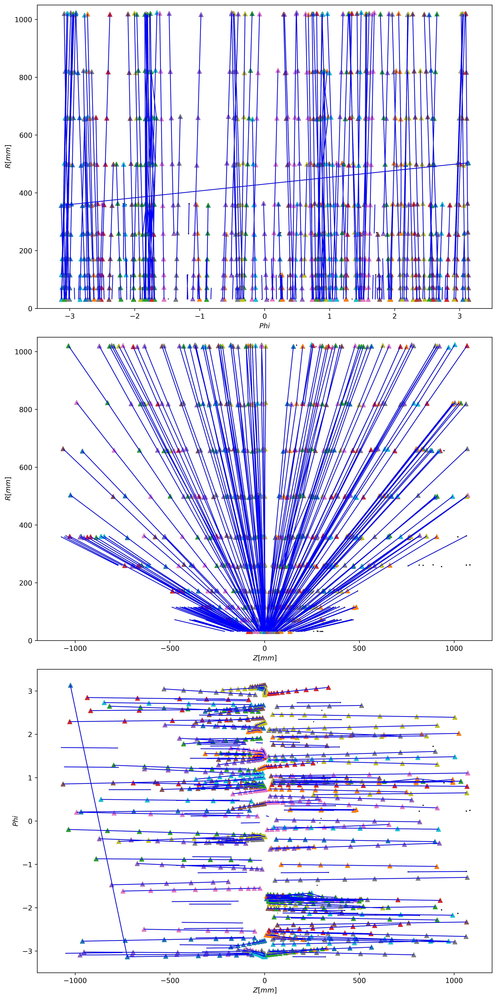

In [17]:
draw_sample_with_clusters(X, Ri, Ro, y, out)

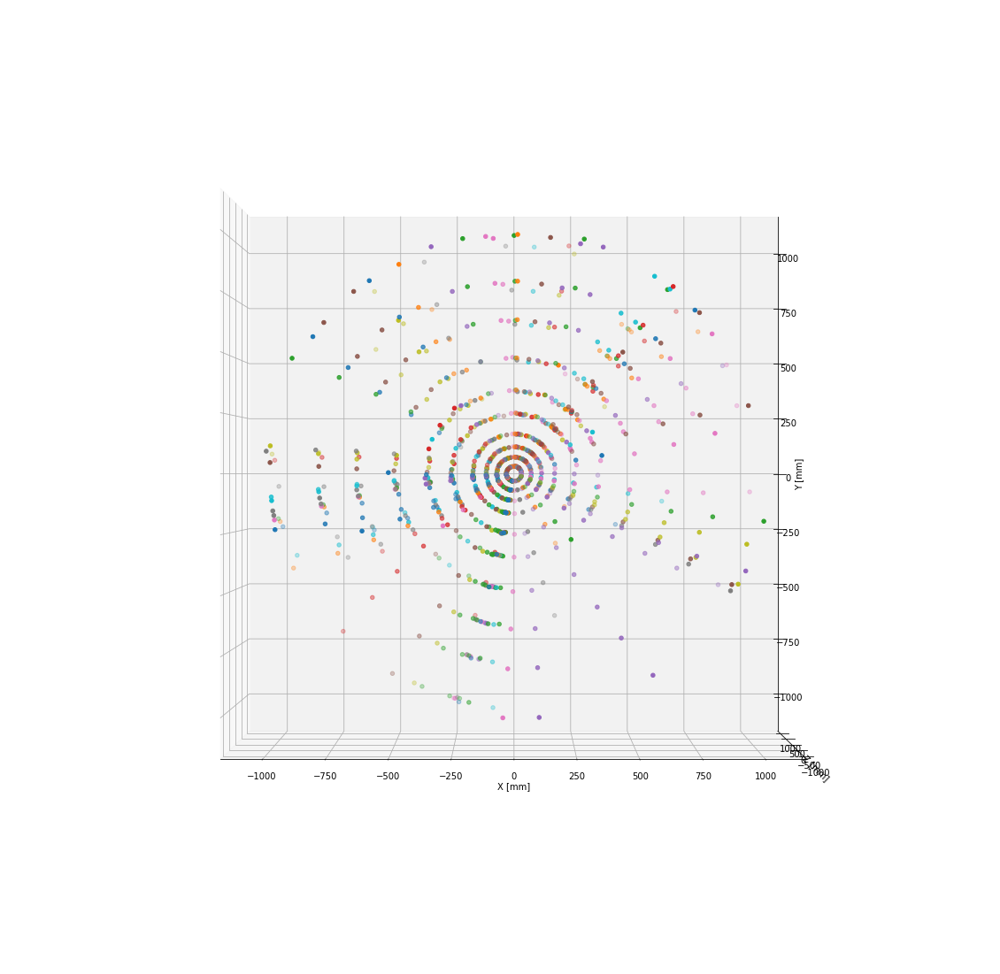

In [18]:
 

fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')

for k, clus in had_clusters_sel.items():
    clu = X[clus]
    r   = 1000*clu[:,0]
    phi = np.pi*clu[:,1]
    z   = 1000*clu[:,2]

    #theta = 2*np.arctan(np.exp(-5*eta))

    x = r*np.cos(phi)
    y = r*np.sin(phi)    
    ax.scatter(x, z, y, zdir='z', depthshade=True)

    ax.set_xlabel('X [mm]')
    ax.set_ylabel('Z [mm]')
    ax.set_zlabel('Y [mm]')
    ax.view_init(0,-90)
    


In [19]:
#%matplotlib inline

#import matplotlib.pyplot as plt
#from matplotlib import collections  as mc

def draw_sample_barrel(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 30))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    

    ax0.scatter(1000*X[:,0]*np.cos(np.pi*X[:,1]), 1000*X[:,0]*np.sin(np.pi*X[:,1]), s=(e_normed), c='k')
    ax1.scatter(1000*X[:,0]*np.cos(np.pi*X[:,1]), 1000*X[:,0]*np.sin(np.pi*X[:,1]), s=(e_normed), c='k')
    ax2.scatter(1000*X[:,0]*np.cos(np.pi*X[:,1]), 1000*X[:,0]*np.sin(np.pi*X[:,1]), s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            lines0.append([(1000*feats_o[j,0]*np.cos(np.pi*feats_o[j,1]), 1000*feats_o[j,0]*np.sin(np.pi*feats_o[j,1])), 
                           (1000*feats_i[j,0]*np.cos(np.pi*feats_i[j,1]), 1000*feats_i[j,0]*np.sin(np.pi*feats_i[j,1]))])
            lines1.append([(1000*feats_o[j,0]*np.cos(np.pi*feats_o[j,1]), 1000*feats_o[j,0]*np.sin(np.pi*feats_o[j,1])), 
                           (1000*feats_i[j,0]*np.cos(np.pi*feats_i[j,1]), 1000*feats_i[j,0]*np.sin(np.pi*feats_i[j,1]))])
            lines2.append([(1000*feats_o[j,0]*np.cos(np.pi*feats_o[j,1]), 1000*feats_o[j,0]*np.sin(np.pi*feats_o[j,1])), 
                           (1000*feats_i[j,0]*np.cos(np.pi*feats_i[j,1]), 1000*feats_i[j,0]*np.sin(np.pi*feats_i[j,1]))])

            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            ax0.plot([1000*feats_o[j,0]*np.cos(np.pi*feats_o[j,1]), 1000*feats_i[j,0]*np.cos(np.pi*feats_i[j,1])],
                     [1000*feats_o[j,0]*np.sin(np.pi*feats_o[j,1]), 1000*feats_i[j,0]*np.sin(np.pi*feats_i[j,1])], '-', **seg_args)

            ax1.plot([1000*feats_o[j,0]*np.cos(np.pi*feats_o[j,1]), 1000*feats_i[j,0]*np.cos(np.pi*feats_i[j,1])],
                     [1000*feats_o[j,0]*np.sin(np.pi*feats_o[j,1]), 1000*feats_i[j,0]*np.sin(np.pi*feats_i[j,1])], '-', **seg_args)

            ax2.plot([1000*feats_o[j,0]*np.cos(np.pi*feats_o[j,1]), 1000*feats_i[j,0]*np.cos(np.pi*feats_i[j,1])],
                     [1000*feats_o[j,0]*np.sin(np.pi*feats_o[j,1]), 1000*feats_i[j,0]*np.sin(np.pi*feats_i[j,1])], '-', **seg_args)

        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    #ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$X [mm]$')
    ax0.set_ylabel('$Y [mm]$')
    ax0.set_xlim(-1050, 1050)
    ax0.set_ylim(-1050, 1050)
    
    ax1.set_xlabel('$X [mm]$')
    ax1.set_ylabel('$Y [mm]$')
    ax1.set_xlim(-1050, 1050)
    ax1.set_ylim(-1050, 1050)
    
    ax2.set_xlabel('$X [mm]$')
    ax2.set_ylabel('$Y [mm]$')
    ax2.set_xlim(-1050, 1050)
    ax2.set_ylim(-1050, 1050)
    
    for k, clus in had_clusters_sel.items():
        clu = X[clus]
        #ax0.scatter(1000*clu[:,0]*np.cos(np.pi*clu[:,1]), 1000*clu[:,0]*np.sin(np.pi*clu[:,1]), marker = '^')
        ax1.scatter(1000*clu[:,0]*np.cos(np.pi*clu[:,1]), 1000*clu[:,0]*np.sin(np.pi*clu[:,1]), marker = '^')
        ax2.scatter(1000*clu[:,0]*np.cos(np.pi*clu[:,1]), 1000*clu[:,0]*np.sin(np.pi*clu[:,1]), marker = '^')
        
    plt.tight_layout()
    fig.savefig(plot_prefix + 'barrel.png')
    #return fig;

In [20]:
#%matplotlib inline

#import matplotlib.pyplot as plt
#from matplotlib import collections  as mc

def draw_sample_R_Phi(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 20))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    
    
    ax0.scatter(np.pi*X[:,1], 1000*X[:,0], s=(e_normed), c='k')
    ax1.scatter(np.pi*X[:,1], 1000*X[:,0], s=(e_normed), c='k')
    ax2.scatter(np.pi*X[:,1], 1000*X[:,0], s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            lines0.append([(np.pi*feats_o[j,1], 1000*feats_o[j,0]), (np.pi*feats_i[j,1], 1000*feats_i[j,0])])
            lines1.append([(np.pi*feats_o[j,1], 1000*feats_o[j,0]), (np.pi*feats_i[j,1], 1000*feats_i[j,0])])
            lines2.append([(np.pi*feats_o[j,1], 1000*feats_o[j,0]), (np.pi*feats_i[j,1], 1000*feats_i[j,0])])
            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            ax0.plot([np.pi*feats_o[j,1], np.pi*feats_i[j,1]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax1.plot([np.pi*feats_o[j,1], np.pi*feats_i[j,1]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax2.plot([np.pi*feats_o[j,1], np.pi*feats_i[j,1]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    #ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$Phi$')
    ax0.set_ylabel('$R [mm]$')
    ax0.set_xlim(-3.5, 3.5)
    ax0.set_ylim(0, 1050)
    
    ax1.set_xlabel('$Phi$')
    ax1.set_ylabel('$R [mm]$')
    ax1.set_xlim(-3.5, 3.5)
    ax1.set_ylim(0, 1050)
    
    ax2.set_xlabel('$Phi$')
    ax2.set_ylabel('$R [mm]$')
    ax2.set_xlim(-3.5, 3.5)
    ax2.set_ylim(0, 1050)
    
    for k, clus in had_clusters_sel.items():
        clu = X[clus]
        #ax0.scatter(np.pi*clu[:,1], 1000*clu[:,0], marker = '^')
        ax1.scatter(np.pi*clu[:,1], 1000*clu[:,0], marker = '^')
        ax2.scatter(np.pi*clu[:,1], 1000*clu[:,0], marker = '^')

    plt.tight_layout()
    fig.savefig(plot_prefix + 'R_Phi.png')
    #return fig;

In [21]:
#%matplotlib inline

#import matplotlib.pyplot as plt
#from matplotlib import collections  as mc

def draw_sample_R_Z(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 20))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    
    
    ax0.scatter(1000*X[:,2],  1000*X[:,0], s=(e_normed), c='k')
    ax1.scatter(1000*X[:,2],  1000*X[:,0], s=(e_normed), c='k')
    ax2.scatter(1000*X[:,2],  1000*X[:,0], s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            lines0.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
            lines1.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
            lines2.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            ax0.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax1.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            ax2.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    #ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$Z [mm]$')
    ax0.set_ylabel('$R [mm]$')
    ax0.set_xlim(-1200, 1200)
    ax0.set_ylim(0, 1050)
    
    ax1.set_xlabel('$Z [mm]$')
    ax1.set_ylabel('$R [mm]$')
    ax1.set_xlim(-1200, 1200)
    ax1.set_ylim(0, 1050)
    
    ax2.set_xlabel('$Z [mm]$')
    ax2.set_ylabel('$R [mm]$')
    ax2.set_xlim(-1200, 1200)
    ax2.set_ylim(0, 1050)
    
    for k, clus in had_clusters_sel.items():
        clu = X[clus]
        #ax0.scatter(1000*clu[:,2],  1000*clu[:,0], marker = '^')
        ax1.scatter(1000*clu[:,2],  1000*clu[:,0], marker = '^')
        ax2.scatter(1000*clu[:,2],  1000*clu[:,0], marker = '^')

    plt.tight_layout()
    fig.savefig(plot_prefix + 'R_Z.png')
    #return fig;

In [22]:
#%matplotlib inline

#import matplotlib.pyplot as plt
#from matplotlib import collections  as mc

def draw_sample_Z_Phi(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 20))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    
    
    ax0.scatter(1000*X[:,2],  np.pi*X[:,1], s=(e_normed), c='k')
    ax1.scatter(1000*X[:,2],  np.pi*X[:,1], s=(e_normed), c='k')
    ax2.scatter(1000*X[:,2],  np.pi*X[:,1], s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            lines0.append([(1000*feats_o[j,2],  np.pi*feats_o[j,1]),(1000*feats_i[j,2],  np.pi*feats_i[j,1])])
            lines1.append([(1000*feats_o[j,2],  np.pi*feats_o[j,1]),(1000*feats_i[j,2],  np.pi*feats_i[j,1])])
            lines2.append([(1000*feats_o[j,2],  np.pi*feats_o[j,1]),(1000*feats_i[j,2],  np.pi*feats_i[j,1])])
            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            ax0.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [np.pi*feats_o[j,1], np.pi*feats_i[j,1]], '-', **seg_args)
            ax1.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [np.pi*feats_o[j,1], np.pi*feats_i[j,1]], '-', **seg_args)
            ax2.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                     [np.pi*feats_o[j,1], np.pi*feats_i[j,1]], '-', **seg_args)
        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    #ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$Z [mm]$')
    ax0.set_ylabel('$Phi$')
    ax0.set_xlim(-1200, 1200)
    ax0.set_ylim(-3.5, 3.5)
    
    ax1.set_xlabel('$Z [mm]$')
    ax1.set_ylabel('$Phi$')
    ax1.set_xlim(-1200, 1200)
    ax1.set_ylim(-3.5, 3.5)
    
    ax2.set_xlabel('$Z [mm]$')
    ax2.set_ylabel('$Phi$')
    ax2.set_xlim(-1200, 1200)
    ax2.set_ylim(-3.5, 3.5)
    
    for k, clus in had_clusters_sel.items():
        clu = X[clus]
        #ax0.scatter(1000*clu[:,2],  np.pi*clu[:,1], marker = '^')
        ax1.scatter(1000*clu[:,2],  np.pi*clu[:,1], marker = '^')
        ax2.scatter(1000*clu[:,2],  np.pi*clu[:,1], marker = '^')

    plt.tight_layout()
    fig.savefig(plot_prefix + 'Z_Phi.png')
    #return fig;

In [23]:
#%matplotlib inline

#import matplotlib.pyplot as plt
#from matplotlib import collections  as mc

def draw_sample_signedR_Z(X, Ri, Ro, y, out,
                cmap='bwr_r', 
                skip_false_edges=True,
                alpha_labels=False, 
                sim_list=None): 
    
    #let's draw only the non-noise edges
    out_mask = out > 0
    Ri = Ri[out_mask]
    Ro = Ro[out_mask]
    good_outs = out[out_mask]
    
    # Select the i/o node features for each segment    
    feats_o = X[Ro]
    feats_i = X[Ri]    
    # Prepare the figure
    fig, (ax0,ax1,ax2) = plt.subplots(3, 1, dpi=400, figsize=(10, 30))
    cmap = plt.get_cmap(cmap)
    
    
    #if sim_list is None:    
        # Draw the hits (layer, x, y)
    #    ax0.scatter(X[:,0], X[:,2], c='k')
    #    ax1.scatter(X[:,1], X[:,2], c='k')
    #else:        
    
    #e_max = np.max(X[:,4])
    #e_normed = np.tanh(X[:,4]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    e_max = np.max(1000*X[:,2])
    e_normed = np.tanh(1000*X[:,2]/e_max)#1. / (1. + np.exp(-X[:,4]/e_max))
    
    for j in tqdm(range(X.shape[0])):
        if np.sin(X[j,1]) > 0:
            ax0.scatter(1000*X[j,2],  1000*X[j,0], s=(e_normed), c='k')
            ax1.scatter(1000*X[j,2],  1000*X[j,0], s=(e_normed), c='k')
            ax2.scatter(1000*X[j,2],  1000*X[j,0], s=(e_normed), c='k')        
        else:
            ax0.scatter(1000*X[j,2],  -1000*X[j,0], s=(e_normed), c='k')
            ax1.scatter(1000*X[j,2],  -1000*X[j,0], s=(e_normed), c='k')
            ax2.scatter(1000*X[j,2],  -1000*X[j,0], s=(e_normed), c='k')
        
        
    lines0 = []
    lines1 = []
    lines2 = []
    colors = []
    # Draw the segments    
    if out is not None:
        #t = tqdm.tqdm()
        color_map = {0: (1,1,1,1),
                     1: (0,0,1,1),
                     2: (1,0,0,1),
                     3: (0,1,0,1)}
        
        for j in tqdm(range(good_outs.shape[0])):
            if np.sin(feats_o[j,1]) > 0:
                lines0.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
                lines1.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
                lines2.append([(1000*feats_o[j,2],  1000*feats_o[j,0]), (1000*feats_i[j,2],  1000*feats_i[j,0])])
            else:
                lines0.append([(1000*feats_o[j,2],  -1000*feats_o[j,0]), (1000*feats_i[j,2],  -1000*feats_i[j,0])])
                lines1.append([(1000*feats_o[j,2],  -1000*feats_o[j,0]), (1000*feats_i[j,2],  -1000*feats_i[j,0])])
                lines2.append([(1000*feats_o[j,2],  -1000*feats_o[j,0]), (1000*feats_i[j,2],  -1000*feats_i[j,0])])
            colors.append(color_map[good_outs[j]])
            
            #_ = ax0.plot([feats_o[j,0], feats_i[j,0]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
            #_ = ax1.plot([feats_o[j,1], feats_i[j,1]],
            #             [feats_o[j,2], feats_i[j,2]], '-', **seg_args)
    else:
        t = tqdm.tqdm(range(y.shape[0]))
        for j in t:
            if y[j]:
                seg_args = dict(c='b', alpha=0.4)
            elif not skip_false_edges:
                seg_args = dict(c='black', alpha=0.4)
            else: continue
                
            if np.sin(feats_o[j,1]) > 0:
                ax0.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                         [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
                ax1.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                         [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
                ax2.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                         [1000*feats_o[j,0],  1000*feats_i[j,0]], '-', **seg_args)
            else:
                ax0.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                         [-1000*feats_o[j,0],  -1000*feats_i[j,0]], '-', **seg_args)
                ax1.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                         [-1000*feats_o[j,0],  -1000*feats_i[j,0]], '-', **seg_args)
                ax2.plot([1000*feats_o[j,2],  1000*feats_i[j,2]],
                         [-1000*feats_o[j,0],  -1000*feats_i[j,0]], '-', **seg_args)
        
    col_arr = np.array(colors)
    lc0 = mc.LineCollection(lines0, colors=col_arr, linewidths=1)
    lc1 = mc.LineCollection(lines1, colors=col_arr, linewidths=1)
    lc2 = mc.LineCollection(lines2, colors=col_arr, linewidths=1)
    
    ax0.add_collection(lc0)
    #ax1.add_collection(lc1)
    ax2.add_collection(lc2)
    # Adjust axes
    ax0.set_xlabel('$Z [mm]$')
    ax0.set_ylabel('$signed R [mm]$')
    ax0.set_xlim(-1200, 1200)
    ax0.set_ylim(-1050, 1050)
    
    ax1.set_xlabel('$Z [mm]$')
    ax1.set_ylabel('$signed R [mm]$')
    ax1.set_xlim(-1200, 1200)
    ax1.set_ylim(-1050, 1050)
    
    ax2.set_xlabel('$Z [mm]$')
    ax2.set_ylabel('$signed R [mm]$')
    ax2.set_xlim(-1200, 1200)
    ax2.set_ylim(-1050, 1050)
    
    for k, clus in had_clusters_sel.items():
        clu = X[clus]
        for j in tqdm(range(clu.shape[0])):
            if np.sin(clu[j,1]) > 0:
                #ax0.scatter(1000*clu[j,2],  1000*clu[j,0], marker = '^')
                ax1.scatter(1000*clu[j,2],  1000*clu[j,0], marker = '^')
                ax2.scatter(1000*clu[j,2],  1000*clu[j,0], marker = '^')
            else:
                #ax0.scatter(1000*clu[j,2],  -1000*clu[j,0], marker = '^')
                ax1.scatter(1000*clu[j,2],  -1000*clu[j,0], marker = '^')
                ax2.scatter(1000*clu[j,2],  -1000*clu[j,0], marker = '^')

    plt.tight_layout()
    fig.savefig(plot_prefix + 'signedR_Z.png')
    #return fig;

/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:55: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:37: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:60: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


/home/markus/miniconda3/envs/hgcal-env/lib/python3.6/site-packages/ipykernel_launcher.py:125: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


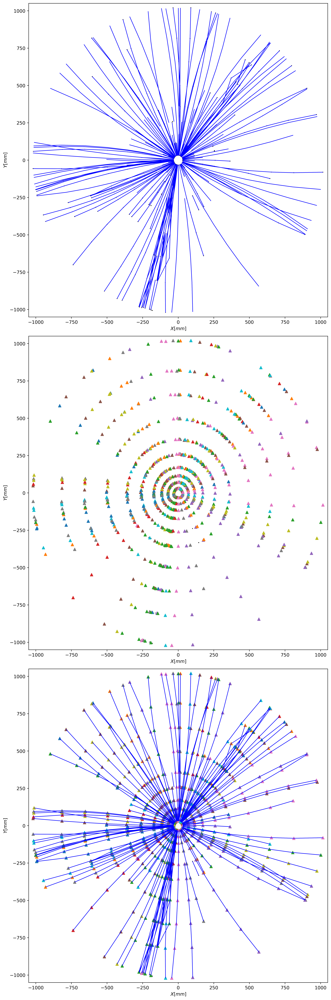

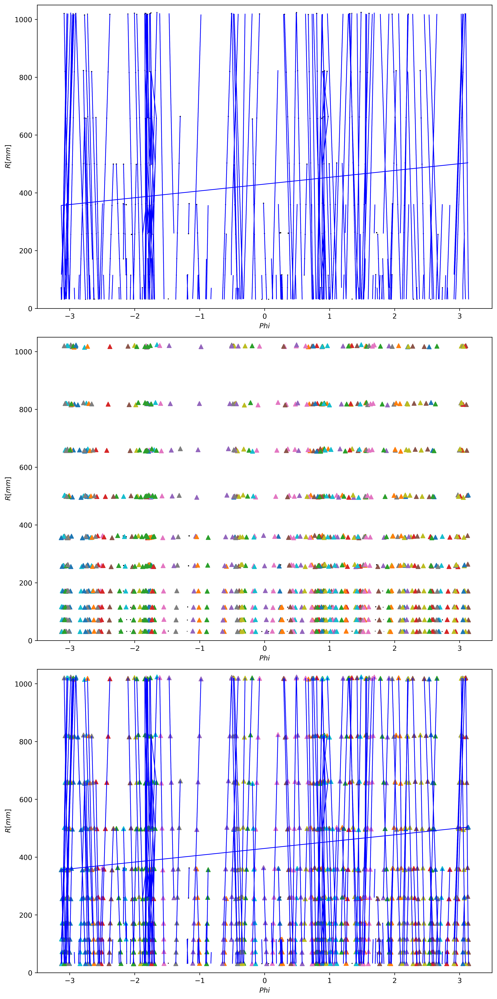

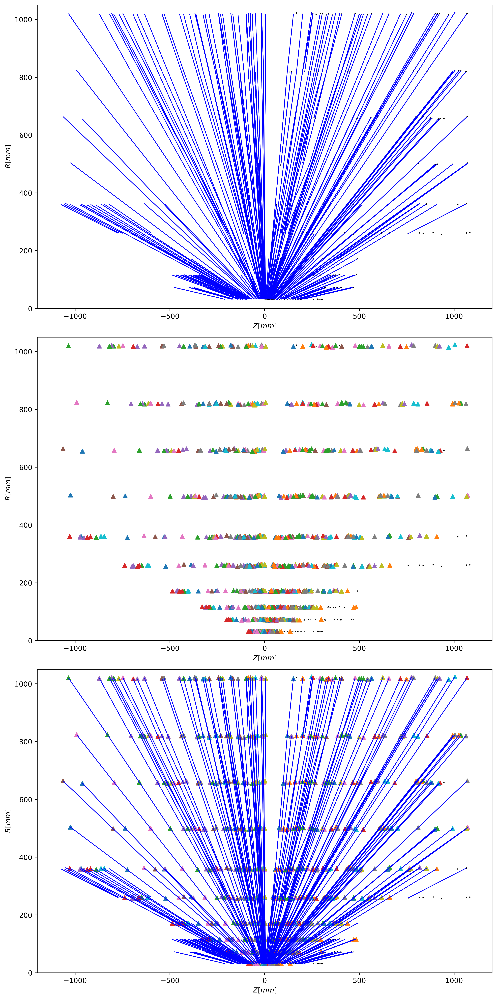

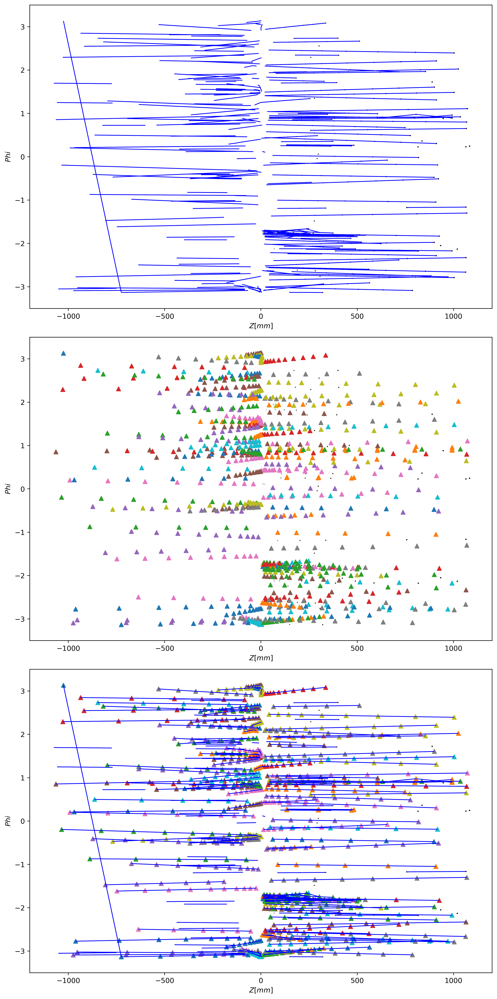

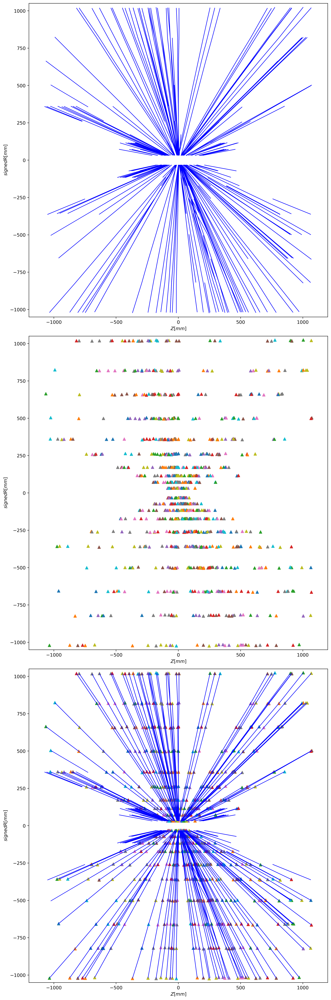

In [24]:
draw_sample_barrel(X, Ri, Ro, y, out)
draw_sample_R_Phi(X, Ri, Ro, y, out)
draw_sample_R_Z(X, Ri, Ro, y, out)
draw_sample_Z_Phi(X, Ri, Ro, y, out)
draw_sample_signedR_Z(X, Ri, Ro, y, out)
